<a href="https://colab.research.google.com/github/munisdev86/stable-diffusion/blob/main/stable_diffusion_2.1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# !pip install --upgrade git+https://github.com/huggingface/diffusers.git transformers accelerate scipy

# Referring https://github.com/qunash/stable-diffusion-2-gui

In [ ]:
!df -h

Filesystem      Size  Used Avail Use% Mounted on
overlay          79G   28G   51G  35% /
tmpfs            64M     0   64M   0% /dev
shm             5.7G     0  5.7G   0% /dev/shm
/dev/root       2.0G  1.1G  910M  54% /sbin/docker-init
/dev/sda1        75G   41G   34G  55% /opt/bin/.nvidia
tmpfs           6.4G   48K  6.4G   1% /var/colab
tmpfs           6.4G     0  6.4G   0% /proc/acpi
tmpfs           6.4G     0  6.4G   0% /proc/scsi
tmpfs           6.4G     0  6.4G   0% /sys/firmware


In [ ]:
# !pip install diffusers

In [ ]:
!pip install --upgrade diffusers transformers accelerate scipy
!pip install triton
!pip install ftfy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 18.2 MB 234 kB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 53 kB 130 kB/s 


In [ ]:
### install xformers
from IPython.utils import capture
from subprocess import getoutput
from re import search

with capture.capture_output() as cap:
    
    smi_out = getoutput('nvidia-smi')
    supported = search('(T4|P100|V100|A100|K80)', smi_out)

    if not supported:
      while True:
        print("\x1b[1;31mThe current GPU is not supported, try starting a new session.\x1b[0m")
    else:
      supported = supported.group(0)

!pip install -q https://github.com/TheLastBen/fast-stable-diffusion/raw/main/precompiled/{supported}/xformers-0.0.13.dev0-py3-none-any.whl

In [ ]:
# !pip install -q https://github.com/ShivamShrirao/xformers-wheels/releases/download/4c06c79/xformers-0.0.15.dev0+4c06c79.d20221201-cp38-cp38-linux_x86_64.whl

In [ ]:
# !pip install git+https://github.com/facebookresearch/xformers@4c06c79#egg=xformers

In [ ]:
from diffusers import StableDiffusionPipeline, EulerDiscreteScheduler, StableDiffusionUpscalePipeline
import torch
from PIL import Image

model_id = "stabilityai/stable-diffusion-2"

attn_slicing_enabled = True
mem_eff_attn_enabled = True







In [ ]:
# Use the Euler scheduler here instead
scheduler = EulerDiscreteScheduler.from_pretrained(model_id, subfolder="scheduler")
pipe = StableDiffusionPipeline.from_pretrained(model_id, scheduler=scheduler, revision="fp16", torch_dtype=torch.float16)
pipe = pipe.to("cuda")

Fetching 12 files:   0%|          | 0/12 [00:00<?, ?it/s]

In [ ]:
!nvidia-smi


Sun Dec  4 10:08:32 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   45C    P0    26W /  70W |   6362MiB / 15109MiB |     13%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
!lscpu

Architecture:        x86_64
CPU op-mode(s):      32-bit, 64-bit
Byte Order:          Little Endian
CPU(s):              2
On-line CPU(s) list: 0,1
Thread(s) per core:  2
Core(s) per socket:  1
Socket(s):           1
NUMA node(s):        1
Vendor ID:           GenuineIntel
CPU family:          6
Model:               85
Model name:          Intel(R) Xeon(R) CPU @ 2.00GHz
Stepping:            3
CPU MHz:             2000.140
BogoMIPS:            4000.28
Hypervisor vendor:   KVM
Virtualization type: full
L1d cache:           32K
L1i cache:           32K
L2 cache:            1024K
L3 cache:            39424K
NUMA node0 CPU(s):   0,1
Flags:               fpu vme de pse tsc msr pae mce cx8 apic sep mtrr pge mca cmov pat pse36 clflush mmx fxsr sse sse2 ss ht syscall nx pdpe1gb rdtscp lm constant_tsc rep_good nopl xtopology nonstop_tsc cpuid tsc_known_freq pni pclmulqdq ssse3 fma cx16 pcid sse4_1 sse4_2 x2apic movbe popcnt aes xsave avx f16c rdrand hypervisor lahf_lm abm 3dnowprefetch invpcid_si

In [ ]:
def set_mem_optimizations(pipe):
    if attn_slicing_enabled:
      pipe.enable_attention_slicing()
    else:
      pipe.disable_attention_slicing()
    
    if mem_eff_attn_enabled:
      pipe.enable_xformers_memory_efficient_attention()
    else:
      pipe.disable_xformers_memory_efficient_attention()

In [ ]:
def get_upscale_pipe(scheduler):
    
    # update_state("Loading upscale model...")

    pipe = StableDiffusionUpscalePipeline.from_pretrained(
      "stabilityai/stable-diffusion-x4-upscaler",
      revision="fp16" if torch.cuda.is_available() else "fp32",
      torch_dtype=torch.float16 if torch.cuda.is_available() else torch.float32,
      # scheduler=scheduler
    )
    # pipe.scheduler = DPMSolverMultistepScheduler.from_config(pipe.scheduler.config)
    set_mem_optimizations(pipe)
    pipe.to("cuda")
    return pipe

In [ ]:
def upscale(prompt, n_images, neg_prompt, img, guidance, steps, generator):

    global pipe_upscale
    if pipe_upscale is None:
      pipe_upscale = get_upscale_pipe(scheduler)

    # img = img['image']
    return upscale_tiling(prompt, neg_prompt, img, guidance, steps, generator)

    # result = pipe_upscale(
    #     prompt,
    #     image = img,
    #     num_inference_steps = int(steps),
    #     guidance_scale = guidance,
    #     negative_prompt = neg_prompt,
    #     num_images_per_prompt = n_images,
    #     generator = generator).images[0]

    # return result

def upscale_tiling(prompt, neg_prompt, img, guidance, steps, generator):

    width, height = img.size

    # calculate the padding needed to make the image dimensions a multiple of 128
    padding_x = 128 - (width % 128) if width % 128 != 0 else 0
    padding_y = 128 - (height % 128) if height % 128 != 0 else 0

    # create a white image of the right size to be used as padding
    padding_img = Image.new('RGB', (padding_x, padding_y), color=(255, 255, 255, 0))

    # paste the padding image onto the original image to add the padding
    img.paste(padding_img, (width, height))

    # update the image dimensions to include the padding
    width += padding_x
    height += padding_y

    if width > 128 or height > 128:

        num_tiles_x = int(width / 128)
        num_tiles_y = int(height / 128)

        upscaled_img = Image.new('RGB', (img.size[0] * 4, img.size[1] * 4))
        for x in range(num_tiles_x):
            for y in range(num_tiles_y):
                print(f"Upscaling tile {x * num_tiles_y + y + 1}/{num_tiles_x * num_tiles_y}")
                tile = img.crop((x * 128, y * 128, (x + 1) * 128, (y + 1) * 128))

                upscaled_tile = pipe_upscale(
                    prompt="",
                    image=tile,
                    num_inference_steps=steps,
                    guidance_scale=guidance,
                    # negative_prompt = neg_prompt,
                    generator=generator,
                ).images[0]

                upscaled_img.paste(upscaled_tile, (x * upscaled_tile.size[0], y * upscaled_tile.size[1]))

        return [upscaled_img]
    else:
        return pipe_upscale(
            prompt=prompt,
            image=img,
            num_inference_steps=steps,
            guidance_scale=guidance,
            negative_prompt = neg_prompt,
            generator=generator,
        ).images



  0%|          | 0/50 [00:00<?, ?it/s]

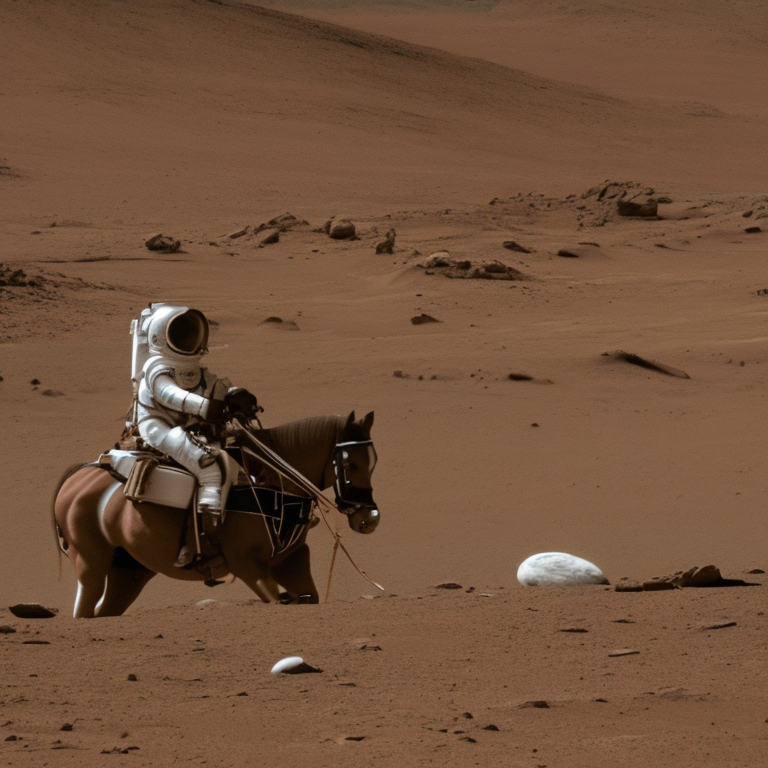

In [ ]:
prompt = "a photo of an astronaut riding a horse on mars"
image = pipe(prompt, height=768, width=768).images[0]
    
image.save("astronaut_rides_horse.png")
image

In [ ]:
seed=0
generator = torch.Generator('cuda').manual_seed(seed) if seed != 0 else None
prompt = ""
neg_prompt=""
guidance = 7.5
steps = 50
pipe_upscale = None

upscaled_image = upscale( prompt, 1,neg_prompt, image, guidance, steps, generator)
upscaled_image

Fetching 14 files:   0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

[<PIL.Image.Image image mode=RGB size=3072x3072 at 0x7F007CAB28E0>]

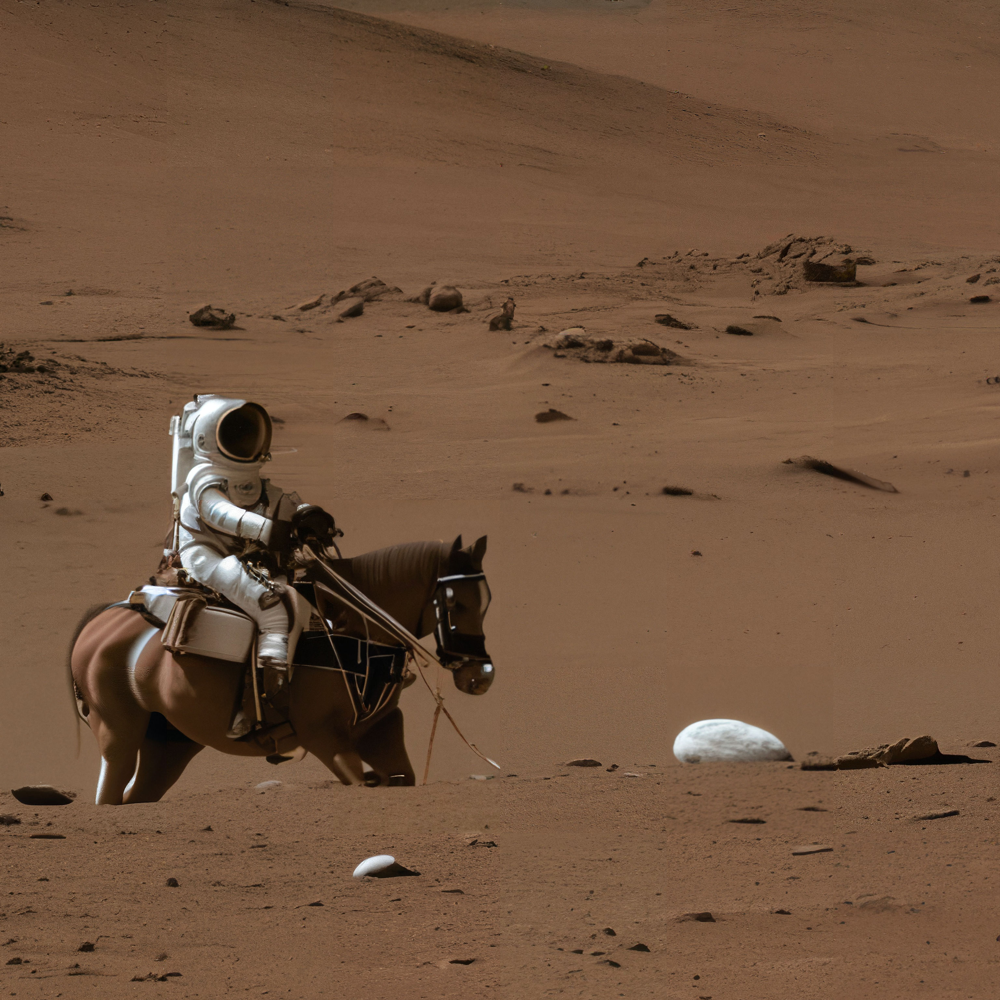

In [ ]:
upscaled_image[0]


In [ ]:
upscaled_image[0].save("astronaut_rides_horse_4k.png")


In [ ]:
prompt = "indian king drawing a painting"
image = pipe(prompt, height=768, width=768).images[0]
image